In [44]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
import cv2

from pathlib import Path
from cellpose import models
from tqdm import tqdm
from matplotlib.colors import Normalize
from sklearn.preprocessing import minmax_scale
from scipy.ndimage import binary_dilation

from data import Dataset, min_max_scale
from component_analysis import ImagePCA
from normalize_background import fit_polynomial_background

# Load Data

In [3]:
# Get dataset paths from .env file
dataset_path_1 = Path(os.getenv('DATASET_PATH_1')) / 'img_raw'
dataset_path_2 = Path(os.getenv('DATASET_PATH_2')) / 'img_raw'

# Create dataset
dataset = Dataset([dataset_path_1, dataset_path_2])

### Visualize Example Image

Visualize the example image channel averages

(13, 1190, 1590)
(13, 1190, 1590)
(13, 1190, 1590)


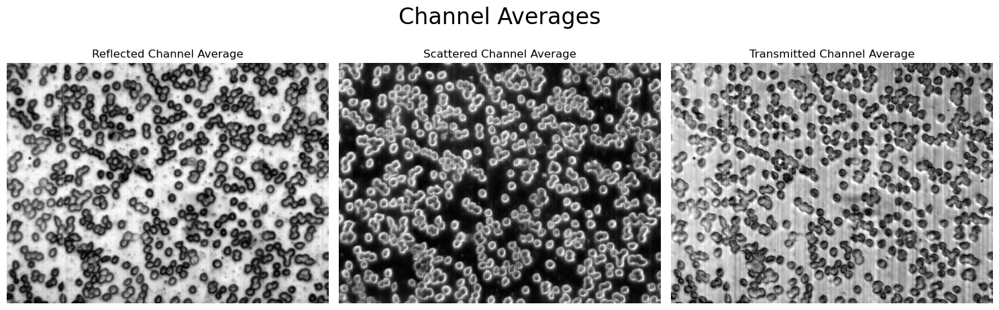

In [131]:
# data = dataset[72]
data = dataset[np.random.randint(0, len(dataset))]

image_R = data['R']
image_S = data['S']
image_T = data['T']

n_edge_pixels = 5
image_R = image_R[:, n_edge_pixels:-n_edge_pixels, n_edge_pixels:-n_edge_pixels]
image_S = image_S[:, n_edge_pixels:-n_edge_pixels, n_edge_pixels:-n_edge_pixels]
image_T = image_T[:, n_edge_pixels:-n_edge_pixels, n_edge_pixels:-n_edge_pixels]

print(image_R.shape)
print(image_S.shape)
print(image_T.shape)

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(minmax_scale(image_R.mean(0)), cmap='gray', vmin=0, vmax=1)
axs[1].imshow(minmax_scale(image_S.mean(0)), cmap='gray', vmin=0, vmax=1)
axs[2].imshow(minmax_scale(image_T.mean(0)), cmap='gray', vmin=0, vmax=1)
axs[0].set_title("Reflected Channel Average")
axs[1].set_title("Scattered Channel Average")
axs[2].set_title("Transmitted Channel Average")
for ax in axs:
    ax.axis(False)
plt.suptitle("Channel Averages", fontsize=24)
plt.tight_layout()
plt.show()

Visualize the example image principal components to better see variations across the image. Note that by looking at the average intensity, we do not see much variation. Looking at the principal channel components however, the variance is better viewed. 

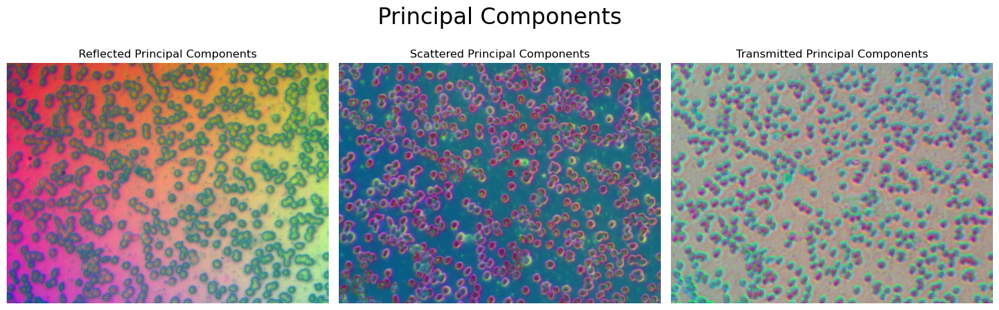

In [132]:
pca_R = ImagePCA(n_components=3)
pca_S = ImagePCA(n_components=3)
pca_T = ImagePCA(n_components=3)

pca_R.fit(image_R)
pca_S.fit(image_S)
pca_T.fit(image_T)

principal_components_image_R = pca_R.transform(image_R)[0]
principal_components_image_S = pca_S.transform(image_S)[0]
principal_components_image_T = pca_T.transform(image_T)[0]

min_R = np.min(principal_components_image_R, (1,2))
max_R = np.max(principal_components_image_R, (1,2))
principal_components_image_R = (principal_components_image_R - min_R[:, None, None]) / (max_R - min_R)[:, None, None]
min_S = np.min(principal_components_image_S, (1,2))
max_S = np.max(principal_components_image_S, (1,2))
principal_components_image_S = (principal_components_image_S - min_S[:, None, None]) / (max_S - min_S)[:, None, None]
min_T = np.min(principal_components_image_T, (1,2))
max_T = np.max(principal_components_image_T, (1,2))
principal_components_image_T = (principal_components_image_T - min_T[:, None, None]) / (max_T - min_T)[:, None, None]

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(principal_components_image_R.transpose(1, 2, 0))
axs[1].imshow(principal_components_image_S.transpose(1, 2, 0))
axs[2].imshow(principal_components_image_T.transpose(1, 2, 0))
axs[0].set_title("Reflected Principal Components")
axs[1].set_title("Scattered Principal Components")
axs[2].set_title("Transmitted Principal Components")
for ax in axs:
    ax.axis(False)
plt.suptitle("Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

# Normalizing Image Background

We try normalizing the image by fitting a second degree polynomial plane to the background

First, we need to extract pixels corresponding to background

c:\Users\ollee\anaconda3\envs\MultispectralMalariaProject\Lib\site-packages\cellpose\resnet_torch.py:271: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.lo

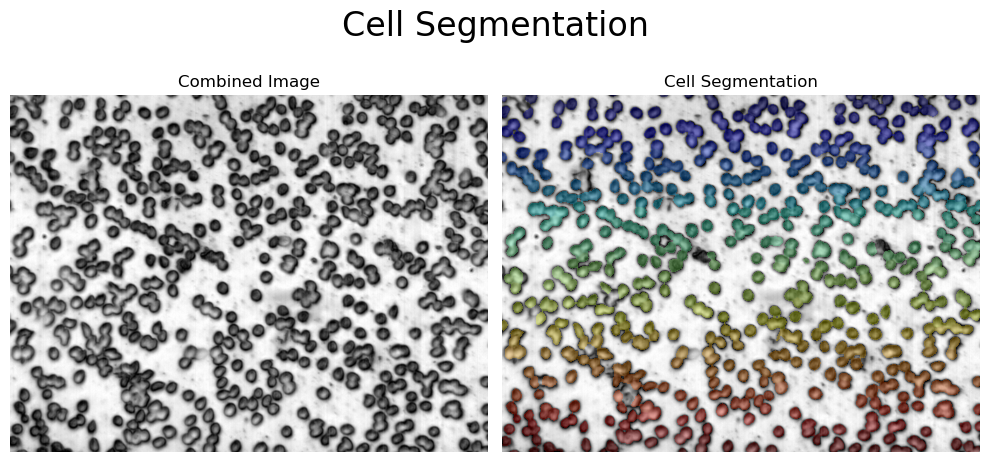

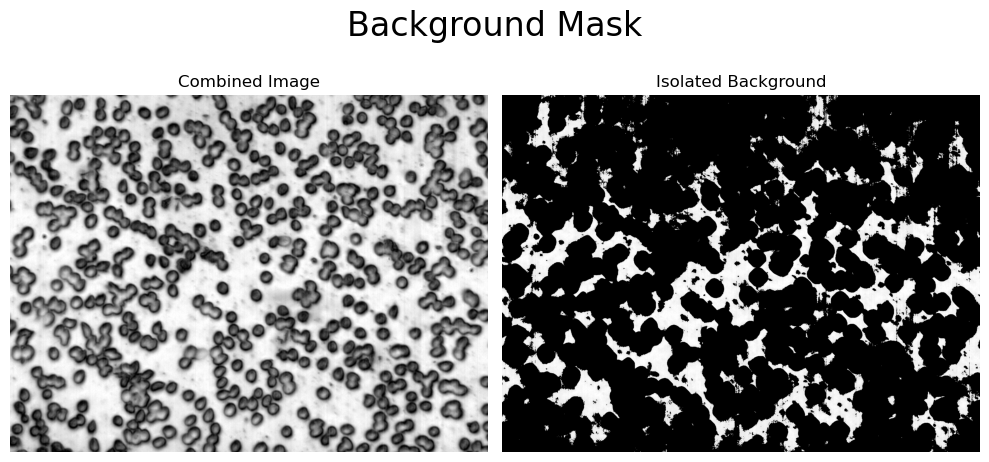

In [ ]:
# Function to get background mask
def get_background_mask(image_R, image_S, image_T, segmentation_model, plot=False):
    # Cell segmentation can be performed on a combined image, averaging all channels in
    # reflected, scattered and transmitted images
    combined_image = minmax_scale(image_R.mean(0)-image_S.mean(0)+image_T.mean(0))
    
    # Segment cells
    mask, _, _, _ = segmentation_model.eval(combined_image, channels=[0, 0], diameter=35)

    # Convert into binary mask where 1 indicates cell and 0 indicates background
    background_mask = np.where(mask == 0, 0, 1)

    # Dilude mask a bit
    background_mask = binary_dilation(background_mask, iterations=10)

    # Compute the average value of the background and filter out pixels deviating to 
    # remove pixels the segmentation missed. Assumes that background is quite uniform. 
    intensity_deviation_threshold = 0.01
    background_pixels = combined_image[background_mask == 0]
    mean_intensity = np.mean(background_pixels)
    deviation_mask = (combined_image - mean_intensity) < intensity_deviation_threshold
    background_mask[deviation_mask & (background_mask == 0)] = 1

    # Plot combined image and masks
    if plot:
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        colormap = plt.cm.jet
        colormap.set_under(color='black')
        norm = Normalize(vmin=0.5, vmax=mask.max())
        axes[0].imshow(combined_image, cmap="gray", vmin=0, vmax=1)
        axes[0].set_title("Combined Image")
        axes[0].axis(False)
        masked_mask = np.ma.masked_where(mask == 0, mask)
        axes[1].imshow(combined_image, cmap="gray", vmin=0, vmax=1)
        axes[1].imshow(masked_mask, cmap=colormap, norm=norm, alpha=0.3)
        axes[1].set_title("Cell Segmentation")
        axes[1].axis(False)
        plt.suptitle("Cell Segmentation", fontsize=24)
        plt.tight_layout()
        plt.show()

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        axes[0].imshow(combined_image, cmap="gray", vmin=0, vmax=1)
        axes[0].set_title("Combined Image")
        axes[0].axis(False)
        combined_image[background_mask == 1] = 0
        axes[1].imshow(combined_image, cmap="gray", vmin=0, vmax=1)
        axes[1].set_title("Isolated Background")
        axes[1].axis(False)
        plt.suptitle("Background Mask", fontsize=24)
        plt.tight_layout()
        plt.show()

    return background_mask

# Use CellPose for cell segmentation
segmentation_model = models.Cellpose(model_type='cyto3', gpu=True, device=torch.device('cuda' if torch.cuda.is_available() else 'cpu'))

# Get background mask
background_mask = get_background_mask(image_R, image_S, image_T, segmentation_model, plot=True)

Now we can fit a polynomial plane to the background indicated by the background mask

In [ ]:
# Function to normalize image based on estimating background plane
def normalize_background(image, background_mask, pca):
    # Fit polynomial plane to the background pixels
    normalized_image, fitted_background = fit_polynomial_background(image, background_mask, degree=2)

    # Add back mean value of estimated background to visualize normalization
    normalized_image_with_background = normalized_image + fitted_background.mean((1,2))[:, None, None]

    # Transform to principal components for visualization
    principal_components_image = pca.transform(image)[0]
    principal_components_normalized_image_with_background = pca.transform(normalized_image_with_background)[0]
    principal_components_fitted_background = pca.transform(fitted_background)[0]

    # Compute min and max values of principal components of original image
    min = np.min(principal_components_image, (1,2))
    max = np.max(principal_components_image, (1,2))

    # Rescale normalized image and background for cohesive plotting
    principal_components_normalized_image_with_background = (principal_components_normalized_image_with_background - min[:, None, None]) / (max - min)[:, None, None]
    principal_components_fitted_background = (principal_components_fitted_background - min[:, None, None]) / (max - min)[:, None, None]

    return normalized_image, fitted_background, principal_components_fitted_background, principal_components_normalized_image_with_background

# Normalize images
normalized_image_R, fitted_background_R, principal_components_fitted_background_R, principal_components_normalized_image_R = \
    normalize_background(image_R, background_mask, pca_R)
normalized_image_S, fitted_background_S, principal_components_fitted_background_S, principal_components_normalized_image_S = \
    normalize_background(image_S, background_mask, pca_S)
normalized_image_T, fitted_background_T, principal_components_fitted_background_T, principal_components_normalized_image_T = \
    normalize_background(image_T, background_mask, pca_T)

To visualize the process, the planes at each intermediate stage can be plotted. At the end, the reflected, scattered, and transmitted images are plotted for visual evaluation of normalization. 

Reflected Image Normalization


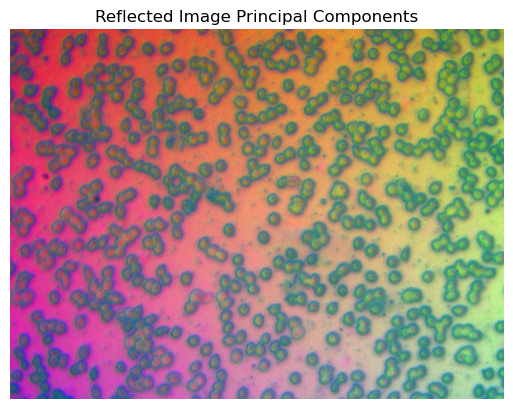

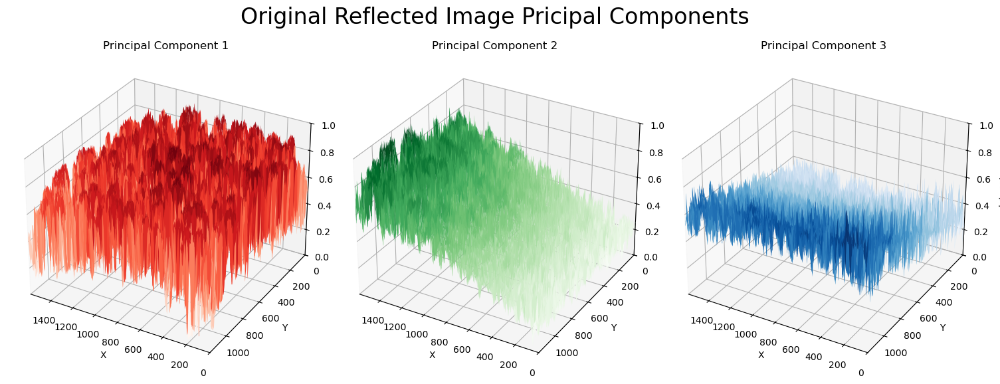

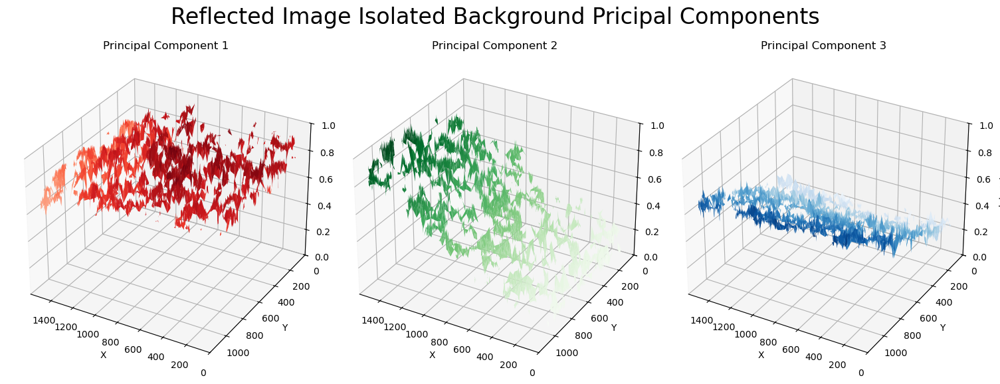

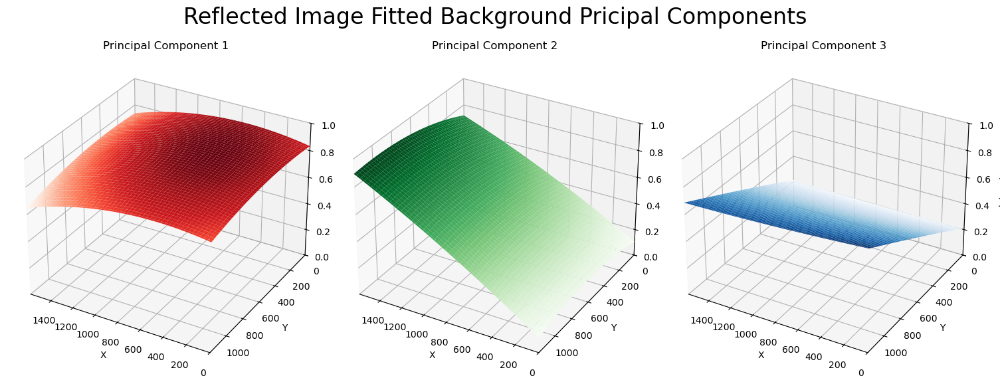

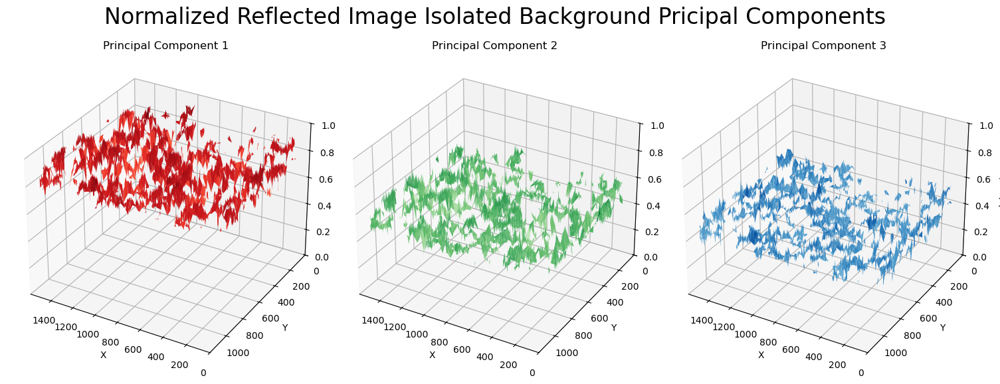

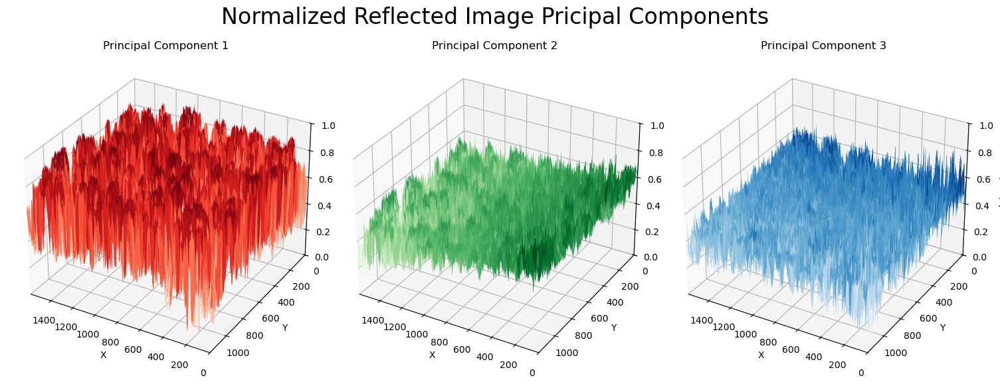

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.049137715..0.9911877].


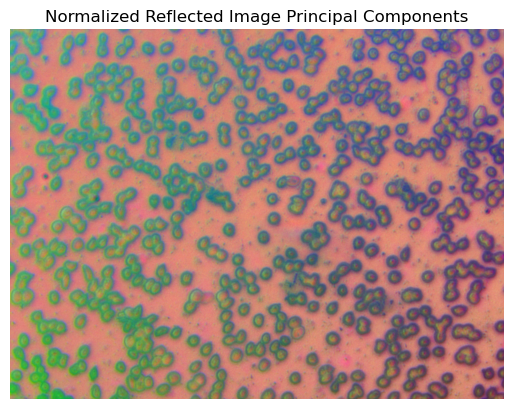

Scattered Image Normalization


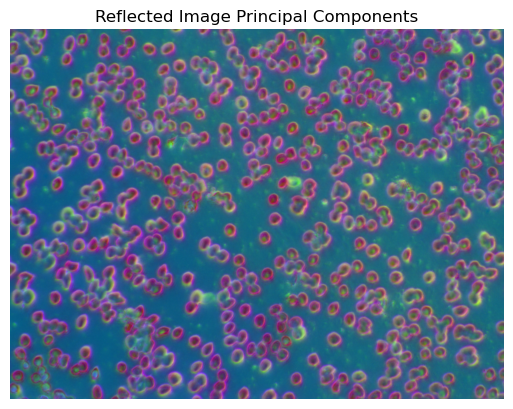

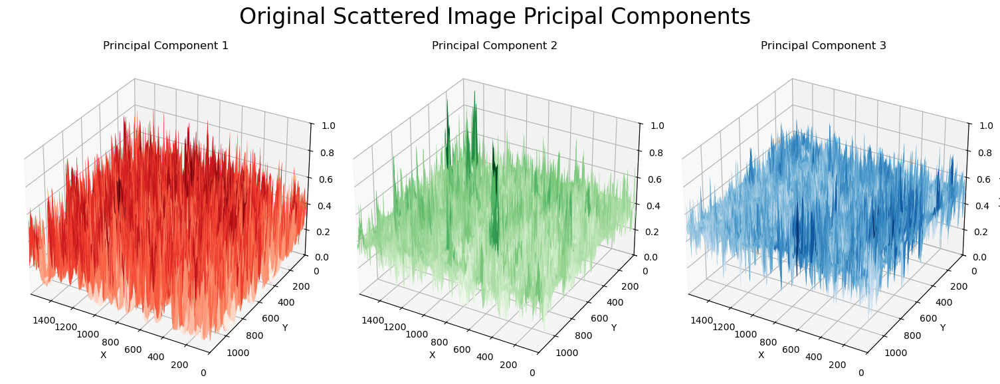

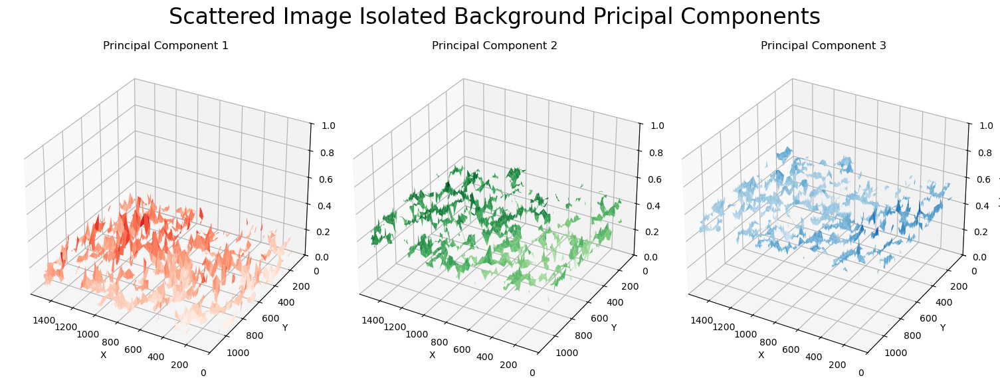

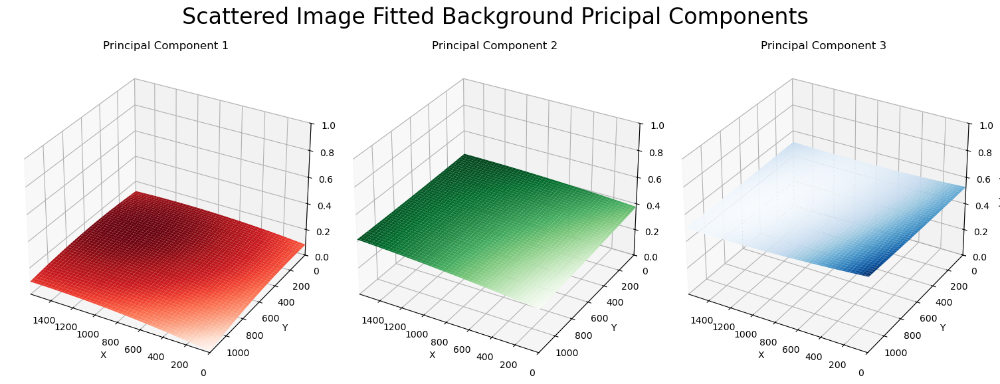

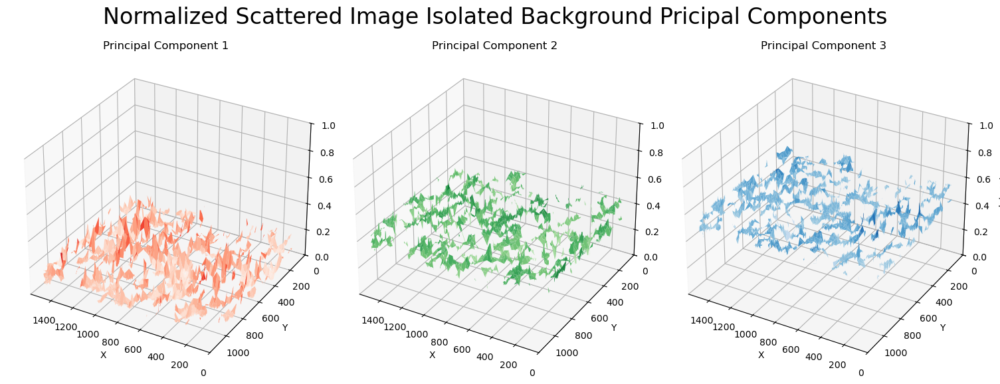

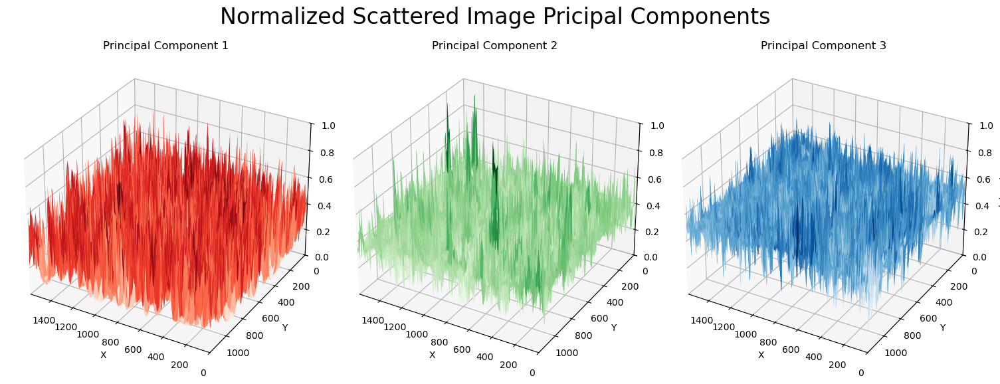

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.008478016..1.0003651].


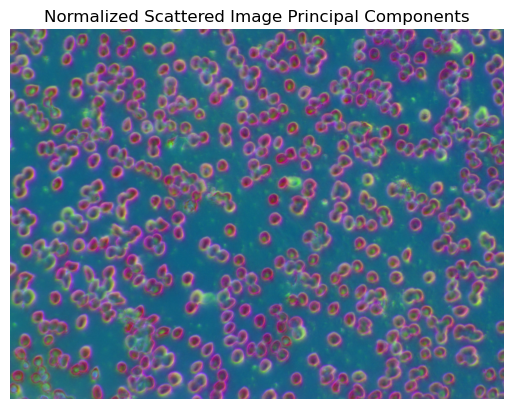

Transmitted Image Normalization


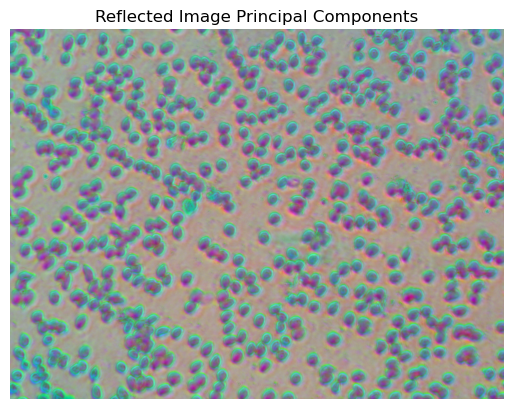

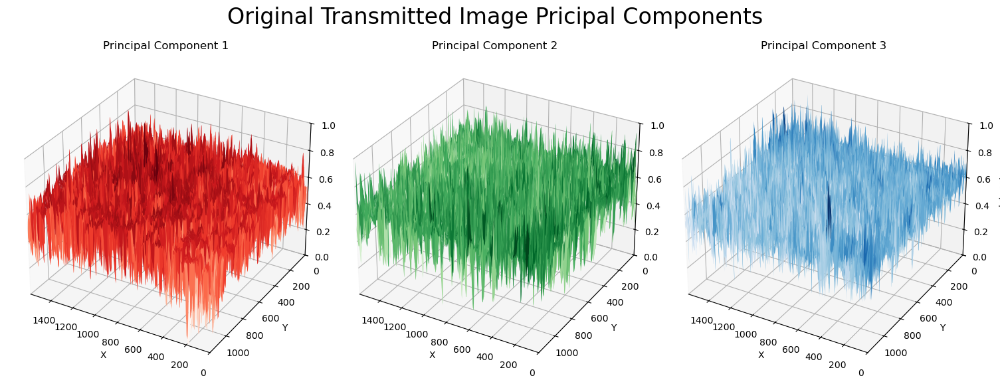

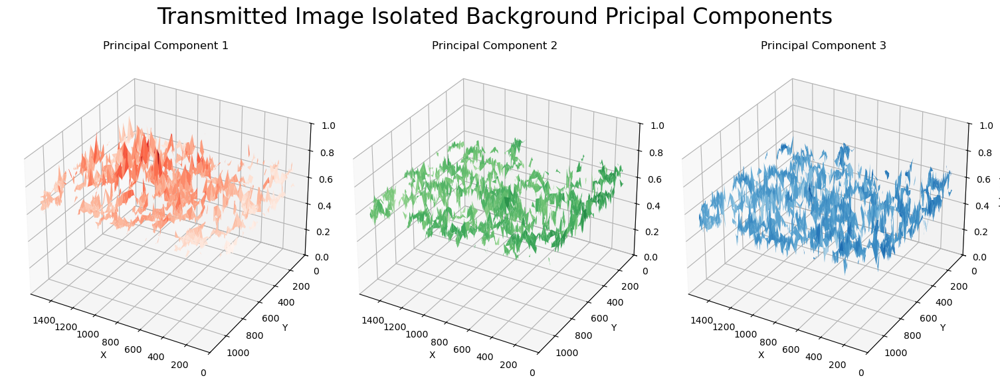

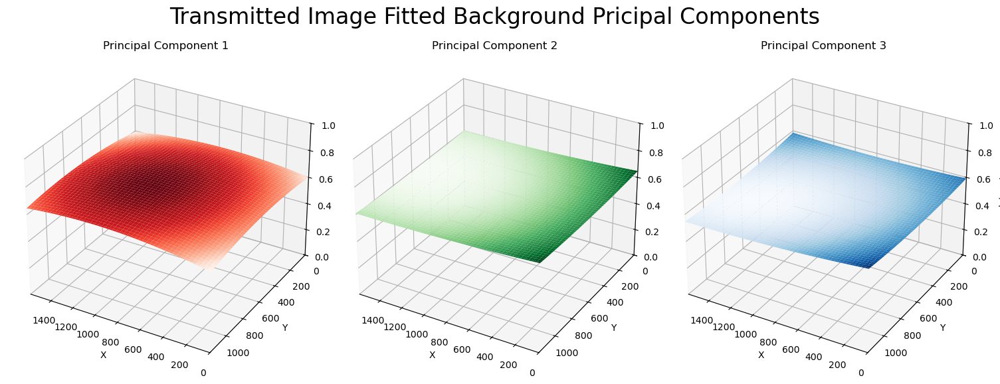

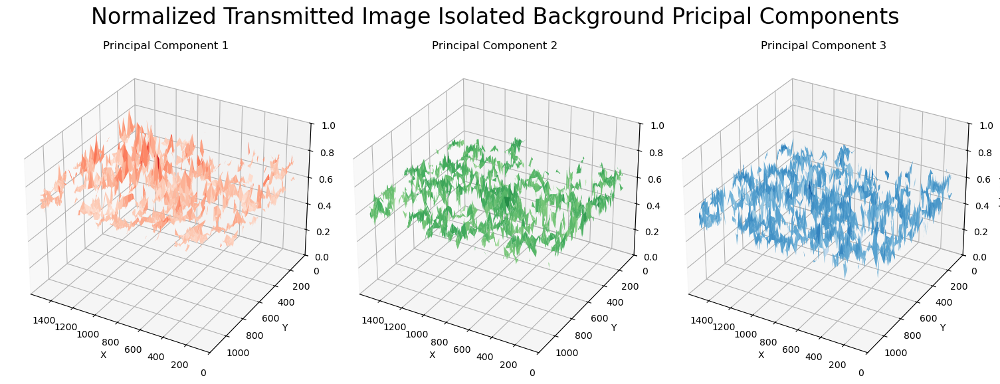

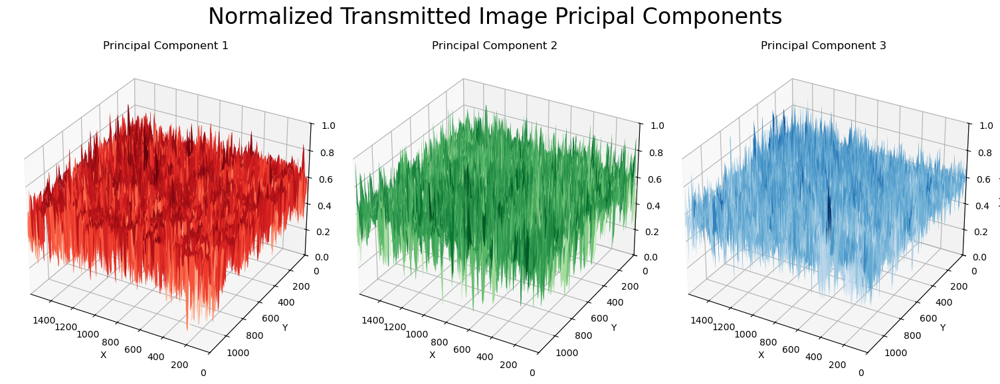

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.013474322..1.0037389].


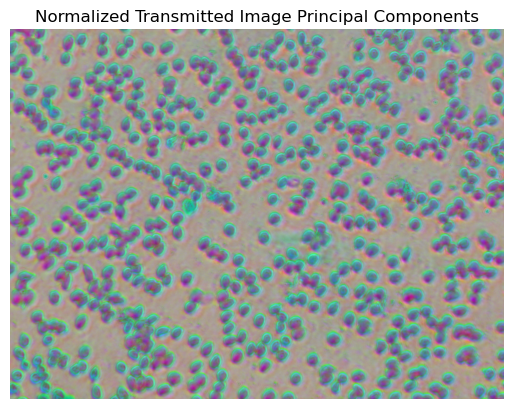

Gathered Results


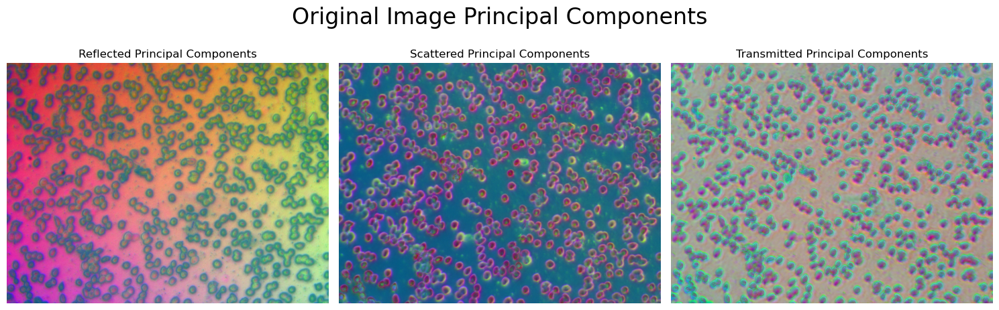

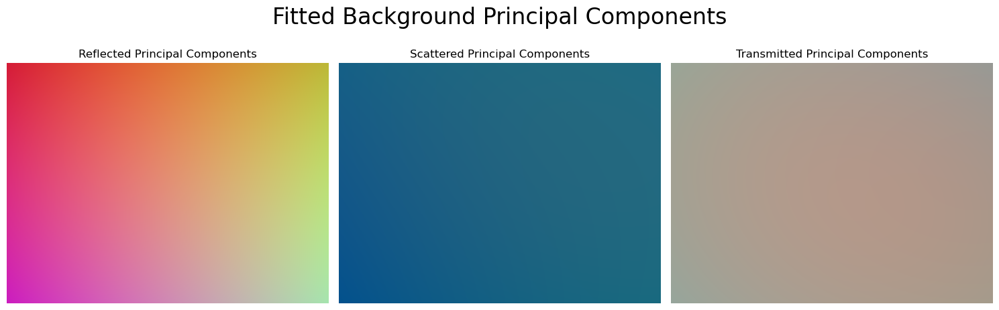

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.049137715..0.9911877].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.008478016..1.0003651].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.013474322..1.0037389].


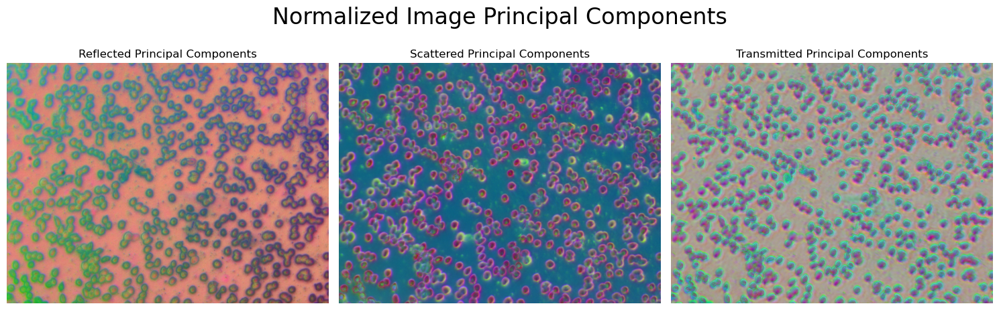

In [155]:
def plot_surface_channels(image, title, mask=None):
    # Create grid for X, Y coordinates
    H, W = image.shape[1:]
    x = np.arange(W)
    y = np.arange(H)
    x, y = np.meshgrid(x, y)

    if not mask is None:
        component_1 = np.where(mask == 0, image[0], np.nan)
        component_2 = np.where(mask == 0, image[1], np.nan)
        component_3 = np.where(mask == 0, image[2], np.nan)
    else:
        component_1 = image[0]
        component_2 = image[1]
        component_3 = image[2]

    fig = plt.figure(figsize=(15, 6))
    # Plot component 1 in x-z plane
    ax1 = fig.add_subplot(131, projection='3d')
    ax1.plot_surface(x, y, component_1, cmap='Reds', edgecolor='none')
    ax1.set_title('Principal Component 1')
    ax1.set_xlabel('X')
    ax1.set_xlim(W-1, 0)
    ax1.set_ylabel('Y')
    ax1.set_ylim(H-1, 0)
    ax1.set_zlabel('Intensity')
    ax1.set_zlim([0, 1])
    # Plot component 2 in y-z plane
    ax2 = fig.add_subplot(132, projection='3d')
    ax2.plot_surface(x, y, component_2, cmap='Greens', edgecolor='none')
    ax2.set_title('Principal Component 2')
    ax2.set_xlabel('X')
    ax2.set_xlim(W-1, 0)
    ax2.set_ylabel('Y')
    ax2.set_ylim(H-1, 0)
    ax2.set_zlabel('Intensity')
    ax2.set_zlim([0, 1])
    # Plot component 3 in x-y plane
    ax3 = fig.add_subplot(133, projection='3d')
    ax3.plot_surface(x, y, component_3, cmap='Blues', edgecolor='none')
    ax3.set_title('Principal Component 3')
    ax3.set_xlabel('X')
    ax3.set_xlim(W-1, 0)
    ax3.set_ylabel('Y')
    ax3.set_ylim(H-1, 0)
    ax3.set_zlabel('Intensity')
    ax3.set_zlim([0, 1])
    plt.suptitle(title, fontsize=24)
    plt.tight_layout()
    plt.show()

print("Reflected Image Normalization")
plt.imshow(principal_components_image_R.transpose(1, 2, 0))
plt.axis(False)
plt.title('Reflected Image Principal Components')
plt.show()
plot_surface_channels(principal_components_image_R, "Original Reflected Image Pricipal Components")
plot_surface_channels(principal_components_image_R, "Reflected Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_fitted_background_R, "Reflected Image Fitted Background Pricipal Components")
plot_surface_channels(principal_components_normalized_image_R, "Normalized Reflected Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_normalized_image_R, "Normalized Reflected Image Pricipal Components")
plt.imshow(principal_components_normalized_image_R.transpose(1, 2, 0))
plt.axis(False)
plt.title('Normalized Reflected Image Principal Components')
plt.show()

print("Scattered Image Normalization")
plt.imshow(principal_components_image_S.transpose(1, 2, 0))
plt.axis(False)
plt.title('Reflected Image Principal Components')
plt.show()
plot_surface_channels(principal_components_image_S, "Original Scattered Image Pricipal Components")
plot_surface_channels(principal_components_image_S, "Scattered Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_fitted_background_S, "Scattered Image Fitted Background Pricipal Components")
plot_surface_channels(principal_components_normalized_image_S, "Normalized Scattered Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_normalized_image_S, "Normalized Scattered Image Pricipal Components")
plt.imshow(principal_components_normalized_image_S.transpose(1, 2, 0))
plt.axis(False)
plt.title('Normalized Scattered Image Principal Components')
plt.show()

print("Transmitted Image Normalization")
plt.imshow(principal_components_image_T.transpose(1, 2, 0))
plt.axis(False)
plt.title('Reflected Image Principal Components')
plt.show()
plot_surface_channels(principal_components_image_T, "Original Transmitted Image Pricipal Components")
plot_surface_channels(principal_components_image_T, "Transmitted Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_fitted_background_T, "Transmitted Image Fitted Background Pricipal Components")
plot_surface_channels(principal_components_normalized_image_T, "Normalized Transmitted Image Isolated Background Pricipal Components", background_mask)
plot_surface_channels(principal_components_normalized_image_T, "Normalized Transmitted Image Pricipal Components")
plt.imshow(principal_components_normalized_image_T.transpose(1, 2, 0))
plt.axis(False)
plt.title('Normalized Transmitted Image Principal Components')
plt.show()

print("Gathered Results")

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(principal_components_image_R.transpose(1, 2, 0))
axs[1].imshow(principal_components_image_S.transpose(1, 2, 0))
axs[2].imshow(principal_components_image_T.transpose(1, 2, 0))
axs[0].set_title("Reflected Principal Components")
axs[1].set_title("Scattered Principal Components")
axs[2].set_title("Transmitted Principal Components")
for ax in axs:
    ax.axis(False)
plt.suptitle("Original Image Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(principal_components_fitted_background_R.transpose(1, 2, 0))
axs[1].imshow(principal_components_fitted_background_S.transpose(1, 2, 0))
axs[2].imshow(principal_components_fitted_background_T.transpose(1, 2, 0))
axs[0].set_title("Reflected Principal Components")
axs[1].set_title("Scattered Principal Components")
axs[2].set_title("Transmitted Principal Components")
for ax in axs:
    ax.axis(False)
plt.suptitle("Fitted Background Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(principal_components_normalized_image_R.transpose(1, 2, 0))
axs[1].imshow(principal_components_normalized_image_S.transpose(1, 2, 0))
axs[2].imshow(principal_components_normalized_image_T.transpose(1, 2, 0))
axs[0].set_title("Reflected Principal Components")
axs[1].set_title("Scattered Principal Components")
axs[2].set_title("Transmitted Principal Components")
for ax in axs:
    ax.axis(False)
plt.suptitle("Normalized Image Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

To check how well the normalization worked, we can fit a new PCA to the normalized data to see remaining variance in the now normalized 13-channel image. 

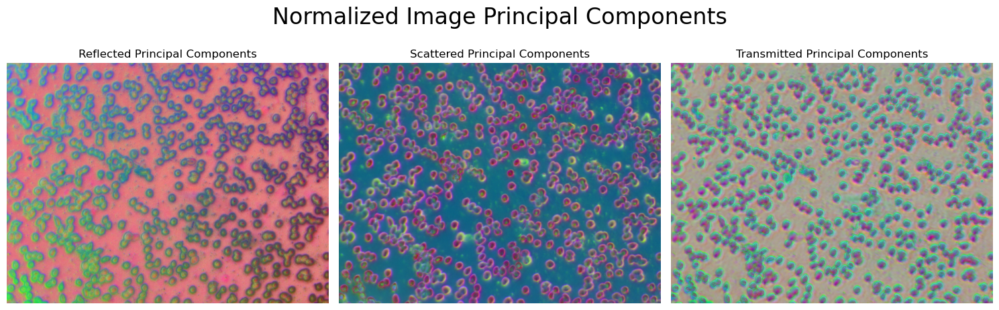

In [162]:
norm_pca_R = ImagePCA()
norm_pca_S = ImagePCA()
norm_pca_T = ImagePCA()
norm_pca_R.fit(normalized_image_R)
norm_pca_S.fit(normalized_image_S)
norm_pca_T.fit(normalized_image_T)
principal_components_normalized_image_R = norm_pca_R.transform(normalized_image_R)[0]
principal_components_normalized_image_S = norm_pca_S.transform(normalized_image_S)[0]
principal_components_normalized_image_T = norm_pca_T.transform(normalized_image_T)[0]

norm_min_R = np.min(principal_components_normalized_image_R, (1,2))
norm_max_R = np.max(principal_components_normalized_image_R, (1,2))
principal_components_normalized_image_R = (principal_components_normalized_image_R - norm_min_R[:, None, None]) / (norm_max_R - norm_min_R)[:, None, None]
norm_min_S = np.min(principal_components_normalized_image_S, (1,2))
norm_max_S = np.max(principal_components_normalized_image_S, (1,2))
principal_components_normalized_image_S = (principal_components_normalized_image_S - norm_min_S[:, None, None]) / (norm_max_S - norm_min_S)[:, None, None]
norm_min_T = np.min(principal_components_normalized_image_T, (1,2))
norm_max_T = np.max(principal_components_normalized_image_T, (1,2))
principal_components_normalized_image_T = (principal_components_normalized_image_T - norm_min_T[:, None, None]) / (norm_max_T - norm_min_T)[:, None, None]

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].imshow(principal_components_normalized_image_R.transpose(1, 2, 0))
axs[1].imshow(principal_components_normalized_image_S.transpose(1, 2, 0))
axs[2].imshow(principal_components_normalized_image_T.transpose(1, 2, 0))
axs[0].set_title("Reflected Principal Components")
axs[1].set_title("Scattered Principal Components")
axs[2].set_title("Transmitted Principal Components")
for ax in axs:
    ax.axis(False)
plt.suptitle("Normalized Image Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

# Normalizing over multiple images

To see how well we can expect this normalization to work over different images, we try normalizing a set of random elements from the dataset. 

In [ ]:
# Define the number of elements to evaluate (e.g., first 10 elements)
# random_elements = [72] + list(np.random.randint(0, len(dataset), 2))
random_elements = np.random.randint(0, len(dataset), 3)

# Store results in lists for later comparison
image_R_list = []
image_S_list = []
image_T_list = []

principal_components_image_R_list = []
principal_components_image_S_list = []
principal_components_image_T_list = []

principal_components_normalized_image_R_list = []
principal_components_normalized_image_S_list = []
principal_components_normalized_image_T_list = []

principal_components_fitted_background_R_list = []
principal_components_fitted_background_S_list = []
principal_components_fitted_background_T_list = []

segmentation_model = models.Cellpose(model_type='cyto3', gpu=True, device=torch.device('cuda' if torch.cuda.is_available() else 'cpu'))

# Loop through the first `num_elements` images in the dataset
for i, idx in enumerate(random_elements):
    print(idx)

    # Retrieve the dataset element
    data = dataset[idx]

    # Extract the images for each channel
    image_R = data['R']
    image_S = data['S']
    image_T = data['T']

    if i == 0:
        # Initialize PCA for each channel
        pca_R = ImagePCA(n_components=3)
        pca_S = ImagePCA(n_components=3)
        pca_T = ImagePCA(n_components=3)

        # Fit PCA to each image
        pca_R.fit(image_R)
        pca_S.fit(image_S)
        pca_T.fit(image_T)
    
    # mask, _, _, _ = segmentation_model.eval(image_R.mean(0)-image_S.mean(0)+image_T.mean(0), channels=[0, 0], diameter=35)

    # # Convert into binary mask where 1 indicates cell and 0 indicates background
    # background_mask = np.where(mask == 0, 0, 1)

    # # Dilude mask a bit
    # background_mask = binary_dilation(background_mask, iterations=10)

    background_mask = get_background_mask(image_R, image_S, image_T, segmentation_model, plot=False)

    # Transform images using PCA
    principal_components_image_R = pca_R.transform(image_R)[0]
    principal_components_image_S = pca_S.transform(image_S)[0]
    principal_components_image_T = pca_T.transform(image_T)[0]

    # Min-max normalization for PCA components
    min_R = np.min(principal_components_image_R, (1, 2))
    max_R = np.max(principal_components_image_R, (1, 2))
    principal_components_image_R = (principal_components_image_R - min_R[:, None, None]) / (max_R - min_R)[:, None, None]

    min_S = np.min(principal_components_image_S, (1, 2))
    max_S = np.max(principal_components_image_S, (1, 2))
    principal_components_image_S = (principal_components_image_S - min_S[:, None, None]) / (max_S - min_S)[:, None, None]

    min_T = np.min(principal_components_image_T, (1, 2))
    max_T = np.max(principal_components_image_T, (1, 2))
    principal_components_image_T = (principal_components_image_T - min_T[:, None, None]) / (max_T - min_T)[:, None, None]

    # Fit polynomial background and normalize images
    normalized_image_second_degree_R, fitted_background_second_degree_R = fit_polynomial_background(image_R, background_mask, degree=2)
    normalized_image_second_degree_S, fitted_background_second_degree_S = fit_polynomial_background(image_S, background_mask, degree=2)
    normalized_image_second_degree_T, fitted_background_second_degree_T = fit_polynomial_background(image_T, background_mask, degree=2)
    # principal_components_normalized_image_second_degree_R = principal_components_image_R
    # principal_components_fitted_background_second_degree_R = principal_components_image_R
    # principal_components_normalized_image_second_degree_S = principal_components_image_S
    # principal_components_fitted_background_second_degree_S = principal_components_image_S
    # principal_components_normalized_image_second_degree_T = principal_components_image_T
    # principal_components_fitted_background_second_degree_T = principal_components_image_T

    # Adjust with mean background
    if i == 0:
        background_reference_R = fitted_background_second_degree_R.mean((1, 2))[:, None, None]
        background_reference_S = fitted_background_second_degree_S.mean((1, 2))[:, None, None]
        background_reference_T = fitted_background_second_degree_T.mean((1, 2))[:, None, None]
    normalized_image_second_degree_R += background_reference_R
    normalized_image_second_degree_S += background_reference_S
    normalized_image_second_degree_T += background_reference_T

    # Transform normalized images with PCA
    principal_components_normalized_image_second_degree_R = pca_R.transform(normalized_image_second_degree_R)[0]
    principal_components_normalized_image_second_degree_S = pca_S.transform(normalized_image_second_degree_S)[0]
    principal_components_normalized_image_second_degree_T = pca_T.transform(normalized_image_second_degree_T)[0]

    # Transform fitted background with PCA
    principal_components_fitted_background_second_degree_R = pca_R.transform(fitted_background_second_degree_R)[0]
    principal_components_fitted_background_second_degree_S = pca_S.transform(fitted_background_second_degree_S)[0]
    principal_components_fitted_background_second_degree_T = pca_T.transform(fitted_background_second_degree_T)[0]

    # Normalize PCA components for all images
    principal_components_normalized_image_second_degree_R = (principal_components_normalized_image_second_degree_R - min_R[:, None, None]) / (max_R - min_R)[:, None, None]
    principal_components_normalized_image_second_degree_S = (principal_components_normalized_image_second_degree_S - min_S[:, None, None]) / (max_S - min_S)[:, None, None]
    principal_components_normalized_image_second_degree_T = (principal_components_normalized_image_second_degree_T - min_T[:, None, None]) / (max_T - min_T)[:, None, None]

    principal_components_fitted_background_second_degree_R = (principal_components_fitted_background_second_degree_R - min_R[:, None, None]) / (max_R - min_R)[:, None, None]
    principal_components_fitted_background_second_degree_S = (principal_components_fitted_background_second_degree_S - min_S[:, None, None]) / (max_S - min_S)[:, None, None]
    principal_components_fitted_background_second_degree_T = (principal_components_fitted_background_second_degree_T - min_T[:, None, None]) / (max_T - min_T)[:, None, None]

    # Append results to lists for later comparison
    image_R_list.append(image_R)
    image_S_list.append(image_S)
    image_T_list.append(image_T)

    principal_components_image_R_list.append(principal_components_image_R)
    principal_components_image_S_list.append(principal_components_image_S)
    principal_components_image_T_list.append(principal_components_image_T)

    principal_components_normalized_image_R_list.append(principal_components_normalized_image_second_degree_R)
    principal_components_normalized_image_S_list.append(principal_components_normalized_image_second_degree_S)
    principal_components_normalized_image_T_list.append(principal_components_normalized_image_second_degree_T)

    principal_components_fitted_background_R_list.append(principal_components_fitted_background_second_degree_R)
    principal_components_fitted_background_S_list.append(principal_components_fitted_background_second_degree_S)
    principal_components_fitted_background_T_list.append(principal_components_fitted_background_second_degree_T)

c:\Users\ollee\anaconda3\envs\MultispectralMalariaProject\Lib\site-packages\cellpose\resnet_torch.py:271: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.lo

61
109
86


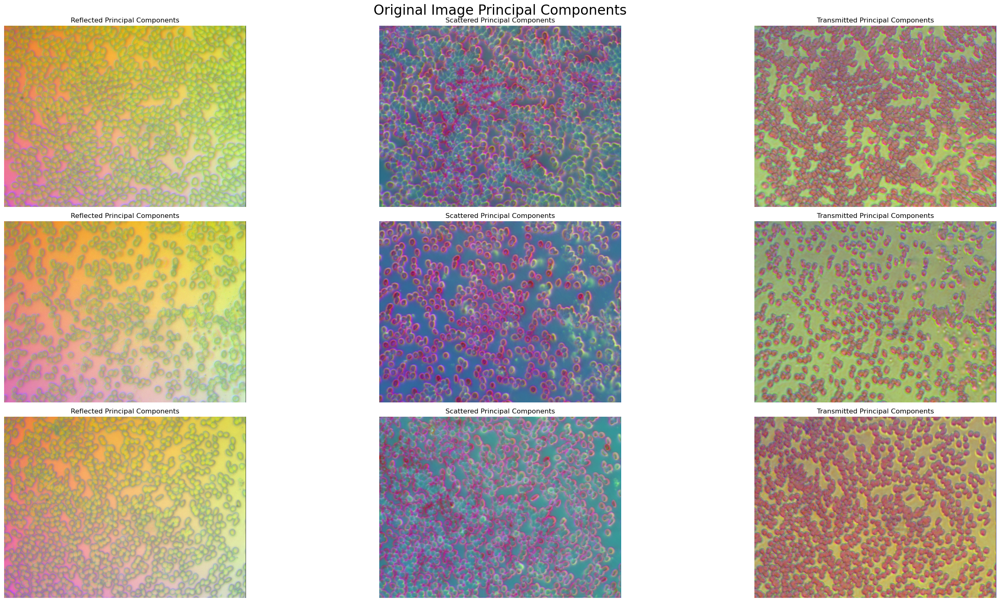

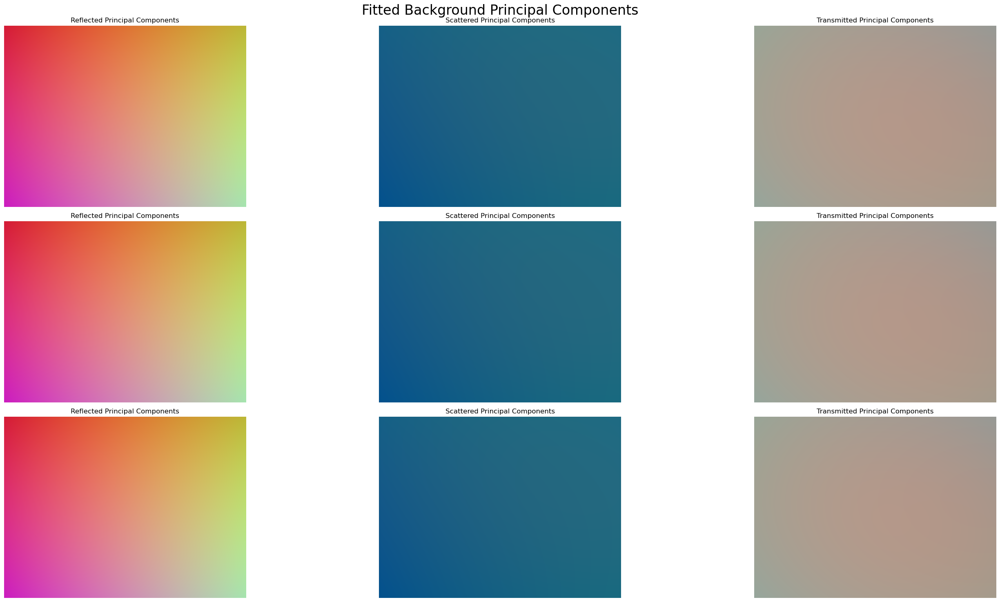

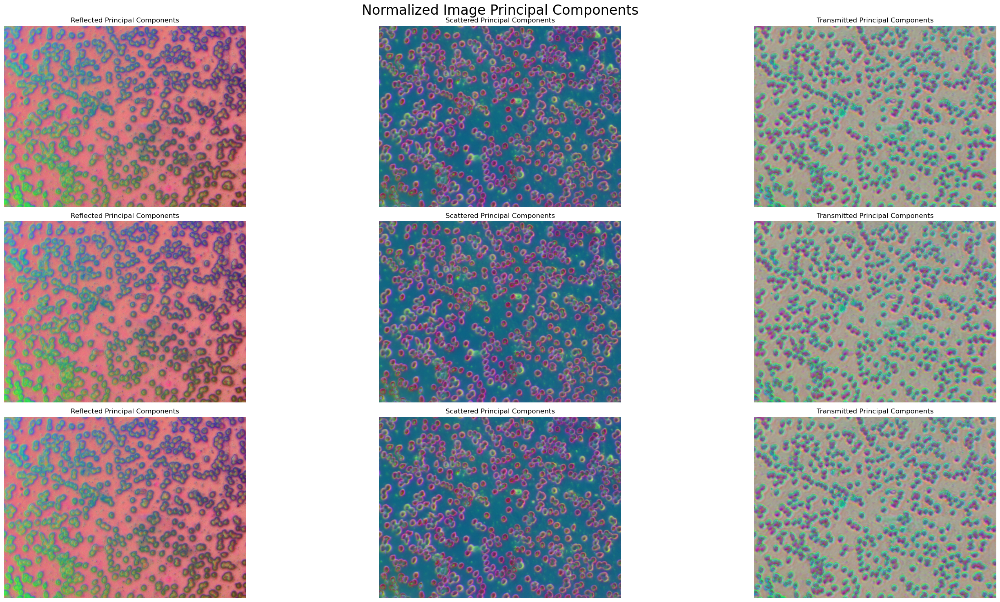

In [165]:
fig, axs = plt.subplots(len(random_elements), 3, figsize=(len(random_elements)*10, 15))
for i in range(len(random_elements)):
    axs[i, 0].imshow(principal_components_image_R_list[i].transpose(1, 2, 0))
    axs[i, 1].imshow(principal_components_image_S_list[i].transpose(1, 2, 0))
    axs[i, 2].imshow(principal_components_image_T_list[i].transpose(1, 2, 0))
    axs[i, 0].set_title("Reflected Principal Components")
    axs[i, 1].set_title("Scattered Principal Components")
    axs[i, 2].set_title("Transmitted Principal Components")
for ax in axs.flatten():
    ax.axis(False)
plt.suptitle("Original Image Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(len(random_elements), 3, figsize=(len(random_elements)*10, 15))
for i in range(len(random_elements)):
    axs[i, 0].imshow(principal_components_fitted_background_R_list[i].transpose(1, 2, 0))
    axs[i, 1].imshow(principal_components_fitted_background_S_list[i].transpose(1, 2, 0))
    axs[i, 2].imshow(principal_components_fitted_background_T_list[i].transpose(1, 2, 0))
    axs[i, 0].set_title("Reflected Principal Components")
    axs[i, 1].set_title("Scattered Principal Components")
    axs[i, 2].set_title("Transmitted Principal Components")
for ax in axs.flatten():
    ax.axis(False)
plt.suptitle("Fitted Background Principal Components", fontsize=24)
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(len(random_elements), 3, figsize=(len(random_elements)*10, 15))
for i in range(len(random_elements)):
    axs[i, 0].imshow(principal_components_normalized_image_R_list[i].transpose(1, 2, 0))
    axs[i, 1].imshow(principal_components_normalized_image_S_list[i].transpose(1, 2, 0))
    axs[i, 2].imshow(principal_components_normalized_image_T_list[i].transpose(1, 2, 0))
    axs[i, 0].set_title("Reflected Principal Components")
    axs[i, 1].set_title("Scattered Principal Components")
    axs[i, 2].set_title("Transmitted Principal Components")
for ax in axs.flatten():
    ax.axis(False)
plt.suptitle("Normalized Image Principal Components", fontsize=24)
plt.tight_layout()
plt.show()